<a href="https://colab.research.google.com/github/ernestojr-7/kaggle_tarifa_taxi/blob/main/Previsao_Tarifa_de_Taxi_de_Nova_Iorque.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Previsão de tarifa de táxi de Nova Iorque

A base de dados foi extraída desta competição do Kaggle: https://www.kaggle.com/c/new-york-city-taxi-fare-prediction/overview. Abaixo a descrição:

> Nesta competição [...] você tem a tarefa de prever o valor da tarifa (inclusive pedágios) para uma corrida de táxi em Nova Iorque, dado os locais de partida e destino. **Embora você possa obter uma estimativa básica baseada apenas na distância entre os dois pontos, isso resultará em um RMSE de 5 a 8**, dependendo do modelo utilizado [...]. Seu desafio é ter resultados melhores do que esses usando técnicas de aprendizagem de máquina!

São disponibilizados duas bases de dados:

>`train.csv` - Características de entrada e valor da taxa, que corresponde a base de dados de treinamento (aproximadamente 55M de linhas).<br>
>`test.csv` - Características de entrada para a base de dados de teste (aproximadamente 10K linhas). O seu objetivo é prever a taxa para cada linha.

Para reduzir o tempo de processamento devido a grande quantidade de dados, foi optado trabalhar com 250k amostras da base de dados de treino disponibilizada para a competição.

## Importação das bibliotecas

In [2]:
import pandas as pd
import numpy as np
import random
import zipfile
import matplotlib.pyplot as plt
from datetime import datetime

## Carregamento da base de dados de treinamento

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
train = pd.read_csv('train_sample_250000.csv',
                    parse_dates = ['key', 'pickup_datetime'],
                    dtype = {'fare_amount': np.float32,
                             'pickup_latitude': np.float32,
                             'pickup_longitude': np.float32,
                             'dropoff_latitude': np.float32,
                             'dropoff_longitude': np.float32,
                             'passenger_count': np.int32             
                    })

In [4]:
train.head()

,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,2011-06-21 16:15:00.000000730,7.300000,2011-06-21 16:15:00+00:00,-73.991875,40.754436,-73.977226,40.774323,3
1,2009-06-06 23:56:00.000000150,5.700000,2009-06-06 23:56:00+00:00,-73.982353,40.762497,-73.973213,40.755344,2
2,2012-04-25 16:19:00.000000106,5.300000,2012-04-25 16:19:00+00:00,-73.971916,40.759251,-73.962906,40.772160,1
3,2009-09-02 05:18:10.000000100,25.700001,2009-09-02 05:18:10+00:00,-73.991730,40.760502,-73.861244,40.767620,1
4,2011-09-24 22:57:00.000000290,4.100000,2011-09-24 22:57:00+00:00,-74.000687,40.742237,-74.000359,40.735275,2


In [5]:
train.dtypes

key                       datetime64[ns]
fare_amount                      float32
pickup_datetime      datetime64[ns, UTC]
pickup_longitude                 float32
pickup_latitude                  float32
dropoff_longitude                float32
dropoff_latitude                 float32
passenger_count                    int32
dtype: object

##Visualização preliminar da disposição dos dados

In [4]:
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip


In [5]:
import pandas_profiling
import warnings
warnings.filterwarnings('ignore')

path = 'train_sample_250000.csv'
df_temp = pd.read_csv(path, nrows=250000)
profile = pandas_profiling.ProfileReport(df_temp)
profile.to_notebook_iframe()
del(df_temp)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Limpeza da base de dados de treinamento

In [ ]:
# verificando existencia de valores nulos
train.isna().sum(axis = 0)

key                  0
fare_amount          0
pickup_datetime      0
pickup_longitude     0
pickup_latitude      0
dropoff_longitude    0
dropoff_latitude     0
passenger_count      0
dtype: int64

### Verificação das datas

#### `key`

In [ ]:
key = train['key']

In [ ]:
key.describe()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  """Entry point for launching an IPython kernel.


count                            250000
unique                           249991
top       2012-03-30 15:32:00.000000200
freq                                  2
first     2009-01-01 00:37:17.000000100
last      2015-06-30 23:59:45.000000100
Name: key, dtype: object

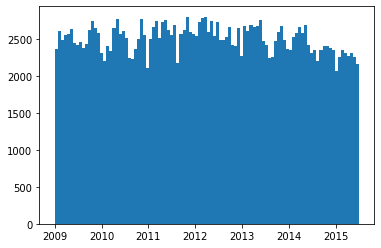

In [ ]:
plt.hist(key, bins = 100);

#### `pickup_datetime`

In [ ]:
pdt = train['pickup_datetime']
pdt.describe()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  


count                        250000
unique                       244650
top       2013-04-04 20:25:00+00:00
freq                              4
first     2009-01-01 00:37:17+00:00
last      2015-06-30 23:59:45+00:00
Name: pickup_datetime, dtype: object

In [ ]:
# realizando formatacao
pdt = pdt.map(lambda date: date.tz_localize(None))

In [ ]:
pdt.head()

0   2011-06-21 16:15:00
1   2009-06-06 23:56:00
2   2012-04-25 16:19:00
3   2009-09-02 05:18:10
4   2011-09-24 22:57:00
Name: pickup_datetime, dtype: datetime64[ns]

In [ ]:
key = pd.to_datetime(key.dt.strftime('%Y-%m-%d %H:%M:%S'))

In [ ]:
key.head()

0   2011-06-21 16:15:00
1   2009-06-06 23:56:00
2   2012-04-25 16:19:00
3   2009-09-02 05:18:10
4   2011-09-24 22:57:00
Name: key, dtype: datetime64[ns]

In [ ]:
# verificando se as colunas 'key' e 'pickup_datetime' sao iguais
(key == pdt).value_counts()

True    250000
dtype: int64

In [ ]:
# removendo coluna 'key'
train.drop(['key'], axis = 1, inplace = True)

In [ ]:
train.head()

,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,7.300000,2011-06-21 16:15:00+00:00,-73.991875,40.754436,-73.977226,40.774323,3
1,5.700000,2009-06-06 23:56:00+00:00,-73.982353,40.762497,-73.973213,40.755344,2
2,5.300000,2012-04-25 16:19:00+00:00,-73.971916,40.759251,-73.962906,40.772160,1
3,25.700001,2009-09-02 05:18:10+00:00,-73.991730,40.760502,-73.861244,40.767620,1
4,4.100000,2011-09-24 22:57:00+00:00,-74.000687,40.742237,-74.000359,40.735275,2


In [ ]:
train['pickup_datetime'] = pdt

In [ ]:
train.head()

,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,7.300000,2011-06-21 16:15:00,-73.991875,40.754436,-73.977226,40.774323,3
1,5.700000,2009-06-06 23:56:00,-73.982353,40.762497,-73.973213,40.755344,2
2,5.300000,2012-04-25 16:19:00,-73.971916,40.759251,-73.962906,40.772160,1
3,25.700001,2009-09-02 05:18:10,-73.991730,40.760502,-73.861244,40.767620,1
4,4.100000,2011-09-24 22:57:00,-74.000687,40.742237,-74.000359,40.735275,2


### Coordenadas

#### `pickup_longitude`

In [ ]:
plon = train['pickup_longitude']
# para analise de valores inconsistentes
plon.describe()

count    250000.000000
mean        -72.528488
std          15.740434
min       -3384.713135
25%         -73.992073
50%         -73.981812
75%         -73.967024
max        2889.983887
Name: pickup_longitude, dtype: float64

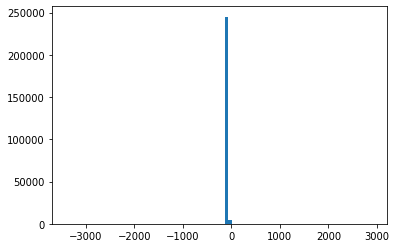

In [ ]:
# para observar valores inconsistentes com histograma 
plt.hist(plon, bins = 100);

In [ ]:
plon.median()

-73.9818115234375

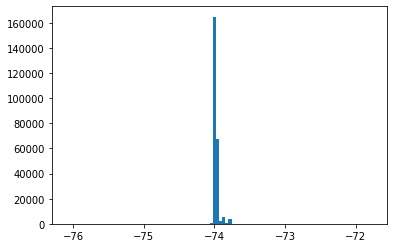

In [ ]:
plt.hist(plon[(plon > plon.median() - 2.5) & (plon < plon.median() + 2.5)], bins = 100);

In [ ]:
plon_val = (plon > plon.median() - 0.5) & (plon < plon.median() + 0.5)

In [ ]:
plon_val.value_counts()

True     244905
False      5095
Name: pickup_longitude, dtype: int64

In [ ]:
print(plon_val.value_counts(), '\n', plon_val.value_counts(normalize = True))

True     244905
False      5095
Name: pickup_longitude, dtype: int64 
 True     0.97962
False    0.02038
Name: pickup_longitude, dtype: float64


#### `pickup_latitude`

In [ ]:
plat = train['pickup_latitude']
plat.describe()

count    250000.000000
mean         39.972263
std           8.903992
min       -2108.157715
25%          40.734966
50%          40.752640
75%          40.767147
max        1978.489990
Name: pickup_latitude, dtype: float64

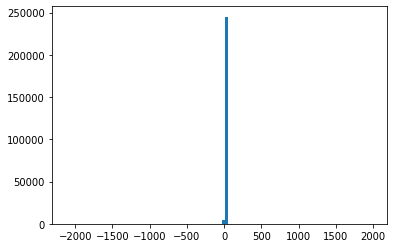

In [ ]:
plt.hist(plat, bins = 100);

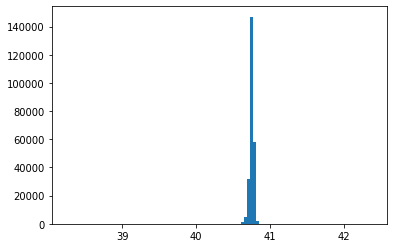

In [ ]:
plt.hist(plat[(plat > plat.median() - 2.5) & (plat < plat.median() + 2.5)], bins = 100);

In [ ]:
plat_val = (plat > plat.median() - 0.5) & (plat < plat.median() + 0.5)
print(plat_val.value_counts(), '\n', plat_val.value_counts(normalize = True))

True     244945
False      5055
Name: pickup_latitude, dtype: int64 
 True     0.97978
False    0.02022
Name: pickup_latitude, dtype: float64


In [ ]:
plat_val

0         True
1         True
2         True
3         True
4         True
          ... 
249995    True
249996    True
249997    True
249998    True
249999    True
Name: pickup_latitude, Length: 250000, dtype: bool

#### `dropoff_longitude`

In [ ]:
dlon = train['dropoff_longitude']
dlon.describe()

count    250000.000000
mean        -72.546288
std          14.218449
min       -3047.714844
25%         -73.991402
50%         -73.980103
75%         -73.963638
max        2554.397217
Name: dropoff_longitude, dtype: float64

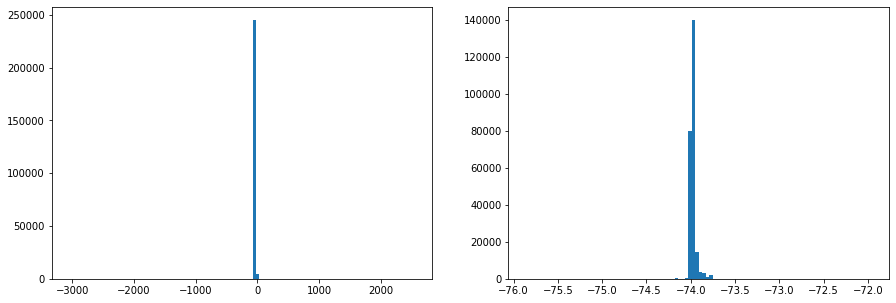

In [ ]:
fig, ax = plt.subplots(1, 2, figsize = (15, 5));
ax[0].hist(dlon, bins = 100);
ax[1].hist(dlon[(dlon > dlon.median() - 2.5) & (dlon < dlon.median() + 2.5)], bins = 100);

In [ ]:
dlon_val = (dlon > dlon.median() - 0.5) & (dlon < dlon.median() + 0.5)
print(dlon_val.value_counts(), '\n', dlon_val.value_counts(normalize = True))

True     244950
False      5050
Name: dropoff_longitude, dtype: int64 
 True     0.9798
False    0.0202
Name: dropoff_longitude, dtype: float64


#### `dropoff_latitude`

In [ ]:
dlat = train['dropoff_latitude']
dlat.describe()

count    250000.000000
mean         39.981991
std          10.486096
min       -2450.704834
25%          40.734032
50%          40.753296
75%          40.768162
max        2561.559082
Name: dropoff_latitude, dtype: float64

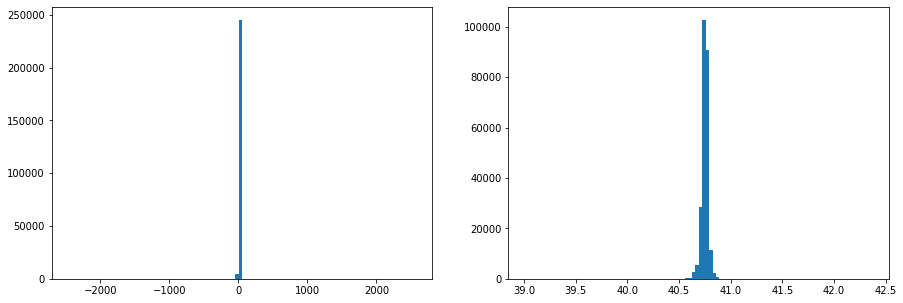

In [ ]:
fig, ax = plt.subplots(1, 2, figsize = (15, 5));
ax[0].hist(dlat, bins = 100);
ax[1].hist(dlat[(dlat > dlat.median() - 2.5) & (dlat < dlat.median() + 2.5)], bins = 100);

In [ ]:
dlat_val = (dlat > dlat.median() - 0.5) & (dlat < dlat.median() + 0.5)
print(dlat_val.value_counts(), '\n', dlat_val.value_counts(normalize = True))

True     244964
False      5036
Name: dropoff_latitude, dtype: int64 
 True     0.979856
False    0.020144
Name: dropoff_latitude, dtype: float64


### Inteiros

#### `passenger_count`

In [ ]:
pcnt = train['passenger_count']
pcnt.describe()

count    250000.000000
mean          1.688128
std           1.375412
min           0.000000
25%           1.000000
50%           1.000000
75%           2.000000
max         208.000000
Name: passenger_count, dtype: float64

In [ ]:
# verificando quantidade de corridas com passageiro nulo
print((pcnt == 0).sum(), (pcnt == 0).mean())

861 0.003444


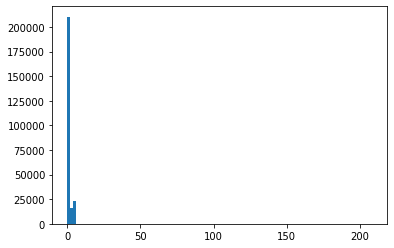

In [ ]:
plt.hist(pcnt, bins = 100);

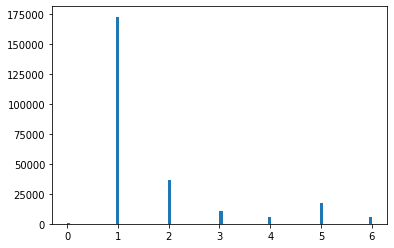

In [ ]:
plt.hist(pcnt[pcnt < 20], bins = 100);

In [ ]:
pcnt_val = (pcnt >= 1) & (pcnt <= 6)
print(pcnt_val.value_counts(), '\n', pcnt_val.value_counts(normalize = True))

True     249138
False       862
Name: passenger_count, dtype: int64 
 True     0.996552
False    0.003448
Name: passenger_count, dtype: float64


### Floats

#### `fare_amount`

In [ ]:
fare = train['fare_amount']
fare.describe()

count    250000.000000
mean         11.328001
std           9.699137
min          -7.700000
25%           6.000000
50%           8.500000
75%          12.500000
max         400.000000
Name: fare_amount, dtype: float64

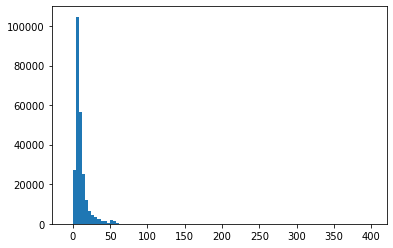

In [ ]:
plt.hist(fare, bins = 100);

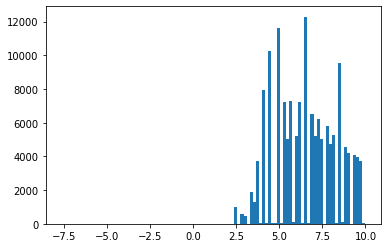

In [ ]:
plt.hist(fare[fare < 10], bins = 100);

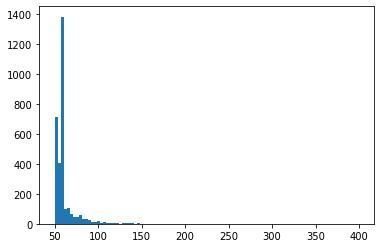

In [ ]:
plt.hist(fare[fare > 50], bins = 100);

In [ ]:
fare_val = (fare > 2) & (fare < 150)
print(fare_val.value_counts(), '\n', fare_val.value_counts(normalize = True))

True     249963
False        37
Name: fare_amount, dtype: int64 
 True     0.999852
False    0.000148
Name: fare_amount, dtype: float64


### Unindo as variáveis

In [ ]:
val_entries = fare_val & plon_val & plat_val & dlon_val & dlat_val & pcnt_val

In [ ]:
print(val_entries.value_counts(), '\n', val_entries.value_counts(normalize = True))

True     243718
False      6282
dtype: int64 
 True     0.974872
False    0.025128
dtype: float64


In [ ]:
train = train.drop(val_entries[val_entries == False].index)

In [ ]:
train.head()

,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,7.300000,2011-06-21 16:15:00,-73.991875,40.754436,-73.977226,40.774323,3
1,5.700000,2009-06-06 23:56:00,-73.982353,40.762497,-73.973213,40.755344,2
2,5.300000,2012-04-25 16:19:00,-73.971916,40.759251,-73.962906,40.772160,1
3,25.700001,2009-09-02 05:18:10,-73.991730,40.760502,-73.861244,40.767620,1
4,4.100000,2011-09-24 22:57:00,-74.000687,40.742237,-74.000359,40.735275,2


In [ ]:
train.shape

(243718, 7)

## Engineering features

Intuitivamente os dois fatores que mais importam na tarifa do táxi é a duração da corrida e a distância



### Duração

A duração da viagem não é dada e não podemos calcular porque a hora de chegada não é dada. Isso faz sentido

porque a intenção do modelo é prever a tarifa **antes** da viagem acontecer

Algo que influencia a duração da viagem é a condição do tráfego. Podemos deduzir usando `pickup_datetime`.

* *hora do dia*: tráfego será menor durante a noite
* *dia da semana*: tráfego será menor nos finais de semana
* *dia do ano*: referiados e férias, por exemplo
* *ano*: pode ser influenciado por mudanças nas regras de transporte ou inflação

In [ ]:
train['hour_of_day'] = train['pickup_datetime'].map(lambda date: date.timetuple().tm_hour)

In [ ]:
train.head()

,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,hour_of_day
0,7.300000,2011-06-21 16:15:00,-73.991875,40.754436,-73.977226,40.774323,3,16
1,5.700000,2009-06-06 23:56:00,-73.982353,40.762497,-73.973213,40.755344,2,23
2,5.300000,2012-04-25 16:19:00,-73.971916,40.759251,-73.962906,40.772160,1,16
3,25.700001,2009-09-02 05:18:10,-73.991730,40.760502,-73.861244,40.767620,1,5
4,4.100000,2011-09-24 22:57:00,-74.000687,40.742237,-74.000359,40.735275,2,22


In [ ]:
train['day_of_week'] = train['pickup_datetime'].map(lambda date: date.timetuple().tm_wday)
train['day_of_year'] = train['pickup_datetime'].map(lambda date: date.timetuple().tm_yday)
train['year'] = train['pickup_datetime'].map(lambda date: date.timetuple().tm_year)

In [ ]:
train.head()

,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,hour_of_day,day_of_week,day_of_year,year
0,7.300000,2011-06-21 16:15:00,-73.991875,40.754436,-73.977226,40.774323,3,16,1,172,2011
1,5.700000,2009-06-06 23:56:00,-73.982353,40.762497,-73.973213,40.755344,2,23,5,157,2009
2,5.300000,2012-04-25 16:19:00,-73.971916,40.759251,-73.962906,40.772160,1,16,2,116,2012
3,25.700001,2009-09-02 05:18:10,-73.991730,40.760502,-73.861244,40.767620,1,5,2,245,2009
4,4.100000,2011-09-24 22:57:00,-74.000687,40.742237,-74.000359,40.735275,2,22,5,267,2011


In [ ]:
# quantidade de corridas em 29 de Fev (ano bissexto)
len(train['pickup_datetime'][train['pickup_datetime'].dt.strftime('%m-%d') == '02-29'])

117

In [ ]:
# dado que sao 117 dias 29 de Fev, foi optado apaga-los
train.drop(train['pickup_datetime'][train['pickup_datetime'].dt.strftime('%m-%d') == '02-29'].index,
           inplace = True)

In [ ]:
train.shape

(243601, 11)

In [ ]:
# como houve retirado dos dias 29 de fev, os numeros de dias seguintes devem ser decrementado em 1 unidade
condition = (train['year'] == 2012) & (train['day_of_year'] > 59)
train['day_of_year'][condition] = train['day_of_year'] - 1

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


Text(0.5, 1.0, 'Year')

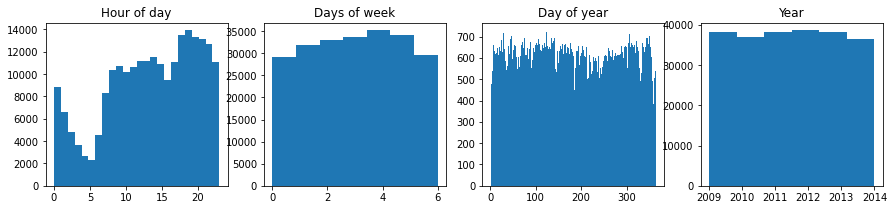

In [ ]:
fig, ax = plt.subplots(1, 4, figsize = (15,3))
train_not_2015 = train[train['year'] < 2015]
ax[0].hist(train_not_2015['hour_of_day'], bins = 24)
ax[0].set_title('Hour of day')
ax[1].hist(train_not_2015['day_of_week'], bins = 7)
ax[1].set_title('Days of week')
ax[2].hist(train_not_2015['day_of_year'], bins = 365)
ax[2].set_title('Day of year')
ax[3].hist(train_not_2015['year'], bins = 6)
ax[3].set_title('Year')

#### Relações entre pickup_datetime e a quantidade de viajens

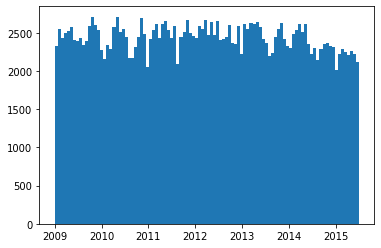

In [ ]:
plt.hist(train['pickup_datetime'], bins = 100);

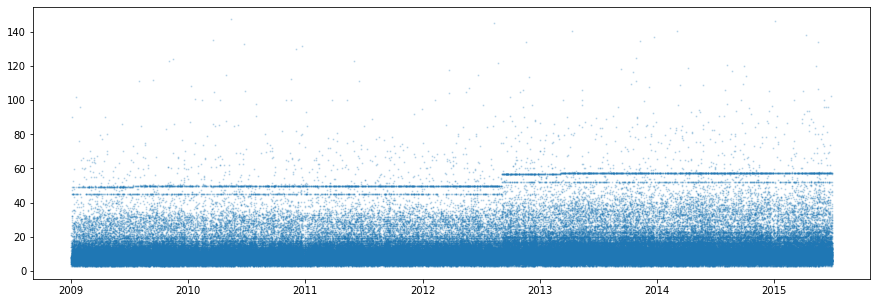

In [ ]:
# verificando aumento da tarifa ao longo dos anos
plt.figure(figsize = (15, 5))
plt.scatter(train['pickup_datetime'], train['fare_amount'], s = 1, alpha = 0.2);

In [ ]:
from collections import Counter
# filtro na regiao media do grafico acima
fare_zoom = train['fare_amount'][(train['fare_amount'] > 40) & (train['fare_amount'] < 60)]

In [ ]:
fare_zoom.shape

(5993,)

In [ ]:
common_fares_zoom = Counter(fare_zoom)

In [ ]:
common_fares_zoom

Counter({40.040000915527344: 7,
         40.099998474121094: 18,
         40.25: 1,
         40.27000045776367: 6,
         40.29999923706055: 9,
         40.33000183105469: 41,
         40.400001525878906: 1,
         40.5: 74,
         40.540000915527344: 5,
         40.650001525878906: 2,
         40.66999816894531: 3,
         40.70000076293945: 1,
         40.7599983215332: 1,
         40.79999923706055: 6,
         40.83000183105469: 47,
         40.900001525878906: 24,
         40.939998626708984: 1,
         41.0: 35,
         41.040000915527344: 7,
         41.04999923706055: 1,
         41.06999969482422: 3,
         41.29999923706055: 31,
         41.33000183105469: 27,
         41.400001525878906: 1,
         41.470001220703125: 4,
         41.5: 37,
         41.540000915527344: 7,
         41.599998474121094: 3,
         41.70000076293945: 24,
         41.79999923706055: 7,
         41.83000183105469: 45,
         41.849998474121094: 1,
         41.869998931884766: 5,
    

In [ ]:
# capturar as 10 taxas mais comuns
most_common_fares_zoom = common_fares_zoom.most_common(10)

In [ ]:
most_common_fares_zoom

[(57.33000183105469, 1059),
 (49.79999923706055, 732),
 (45.0, 673),
 (49.56999969482422, 498),
 (52.0, 415),
 (56.79999923706055, 231),
 (57.540000915527344, 163),
 (49.150001525878906, 142),
 (40.5, 74),
 (50.5, 62)]

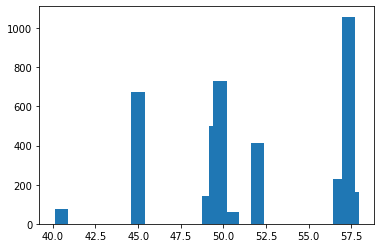

In [ ]:
plt.bar([x[0] for x in most_common_fares_zoom], [x[1] for x in most_common_fares_zoom]);

Exemplo zorder: https://matplotlib.org/2.0.2/examples/pylab_examples/zorder_demo.html

Analisando uma amostra dos pontos de partida e dos pontos de chegada das corridas de táxi

In [ ]:
import folium
from folium import Circle


# Create a base map
map = folium.Map(location=[train.iloc[0]['pickup_latitude'], train.iloc[0]['pickup_longitude']], tiles='cartodbpositron', zoom_start=10)

for i in range(0,len(train['pickup_longitude'][:10000])):
    Circle(
        location=[train.iloc[i]['pickup_latitude'], train.iloc[i]['pickup_longitude']],
        radius=1,
        color='forestgreen').add_to(map)

for i in range(0,len(train['pickup_longitude'][:10000])):
    Circle(
        location=[train.iloc[i]['dropoff_latitude'], train.iloc[i]['dropoff_longitude']],
        radius=1,
        color='darkred').add_to(map)
map

In [ ]:
coords = train[['dropoff_latitude',
                'dropoff_longitude']][(train['fare_amount'] > 40) &
                                       (train['fare_amount'] < 60) &
                                       (train['dropoff_latitude'] < 40.7) &
                                       (train['dropoff_latitude'] > 40.6) &
                                       (train['dropoff_longitude'] < -73.7) &
                                       (train['dropoff_longitude'] > -73.9)]

In [ ]:
coords.shape

(1612, 2)

In [ ]:
coords.head()

,dropoff_latitude,dropoff_longitude
140,40.643787,-73.783150
187,40.643696,-73.783447
300,40.644257,-73.782288
321,40.648746,-73.782425
756,40.648785,-73.782310


In [ ]:
# coordenadas de um aeroporto (por isso a concentracao de pontos verdes e vermelhos)
print(coords['dropoff_latitude'].median(), coords['dropoff_longitude'].median())

40.645118713378906 -73.78643798828125


In [ ]:
coords = train[['dropoff_latitude',
                'dropoff_longitude']][(train['fare_amount'] > 40) &
                                       (train['fare_amount'] < 60) &
                                       (train['dropoff_latitude'] < 40.85) &
                                       (train['dropoff_latitude'] > 40.7) &
                                       (train['dropoff_longitude'] < -73.9) &
                                       (train['dropoff_longitude'] > -74.1)]

In [ ]:
# coordenadas do centro da cidade (por isso a concentracao de pontos verdes e vermelhos)
print(coords['dropoff_latitude'].median(), coords['dropoff_longitude'].median())

40.755348205566406 -73.98301696777344


Experimentação para relação entre preço da corrida e a quantidade de passageiros

In [ ]:
filtered = train[['fare_amount', 
                  'passenger_count']][((train['fare_amount'] == most_common_fares_zoom[0][0]) |
                                       (train['fare_amount'] == most_common_fares_zoom[1][0]) |
                                       (train['fare_amount'] == most_common_fares_zoom[2][0]) |
                                       (train['fare_amount'] == most_common_fares_zoom[4][0]))&
                                       (train['fare_amount'] < 60) &
                                       (train['dropoff_latitude'] < 40.7) & 
                                       (train['dropoff_latitude'] > 40.6) & 
                                       (train['dropoff_longitude'] < -73.7) &
                                       (train['dropoff_longitude'] > -73.9)]

In [ ]:
filtered.shape

(1109, 2)

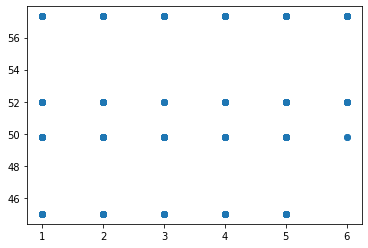

In [ ]:
plt.scatter(filtered['passenger_count'], filtered['fare_amount']);

Experimentação para relação entre preço da corrida e: hora do dia , dia da semana, dia do ano

In [ ]:
filtered = train[['fare_amount', 
                  'hour_of_day',
                  'day_of_week',
                  'day_of_year']][((train['fare_amount'] == most_common_fares_zoom[0][0]) |
                                       (train['fare_amount'] == most_common_fares_zoom[1][0]) |
                                       (train['fare_amount'] == most_common_fares_zoom[2][0]) |
                                       (train['fare_amount'] == most_common_fares_zoom[4][0]))&
                                       (train['fare_amount'] < 60) &
                                       (train['dropoff_latitude'] < 40.7) & 
                                       (train['dropoff_latitude'] > 40.6) & 
                                       (train['dropoff_longitude'] < -73.7) &
                                       (train['dropoff_longitude'] > -73.9)]

In [ ]:
filtered.shape

(1109, 4)

Text(0.5, 1.0, 'Day of year')

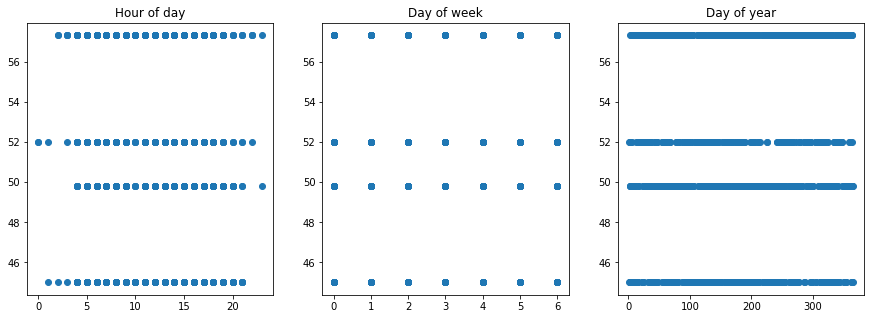

In [ ]:
fig, ax = plt.subplots(1, 3, figsize = (15, 5))
ax[0].scatter(filtered['hour_of_day'], filtered['fare_amount'])
ax[0].set_title('Hour of day')
ax[1].scatter(filtered['day_of_week'], filtered['fare_amount'])
ax[1].set_title('Day of week')
ax[2].scatter(filtered['day_of_year'], filtered['fare_amount'])
ax[2].set_title('Day of year')

In [ ]:
train.drop('pickup_datetime', axis = 1, inplace = True)

In [ ]:
train.head()

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,hour_of_day,day_of_week,day_of_year,year
0,7.300000,-73.991875,40.754436,-73.977226,40.774323,3,16,1,172,2011
1,5.700000,-73.982353,40.762497,-73.973213,40.755344,2,23,5,157,2009
2,5.300000,-73.971916,40.759251,-73.962906,40.772160,1,16,2,115,2012
3,25.700001,-73.991730,40.760502,-73.861244,40.767620,1,5,2,245,2009
4,4.100000,-74.000687,40.742237,-74.000359,40.735275,2,22,5,267,2011


### Distância

In [ ]:
lat1, lat2 = np.radians(train['pickup_latitude']), np.radians(train['dropoff_latitude'])
lon1, lon2 = np.radians(train['pickup_longitude']), np.radians(train['dropoff_longitude'])

In [ ]:
import geopy.distance
coords1 = (lat1, lon1)
coords2 = (lat2, lon2)
dist = []
for i in range(0, len(train['pickup_latitude'])):
    dist.append(geopy.distance.vincenty((train.iloc[i]['pickup_latitude'], train.iloc[i]['pickup_longitude']),
                                       (train.iloc[i]['dropoff_latitude'], train.iloc[i]['dropoff_longitude'])).km)


In [ ]:
train['distance_km'] = dist

In [ ]:
train.head()

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,hour_of_day,day_of_week,day_of_year,year,distance_km
0,7.300000,-73.991875,40.754436,-73.977226,40.774323,3,16,1,172,2011,2.531099
1,5.700000,-73.982353,40.762497,-73.973213,40.755344,2,23,5,157,2009,1.107499
2,5.300000,-73.971916,40.759251,-73.962906,40.772160,1,16,2,115,2012,1.622888
3,25.700001,-73.991730,40.760502,-73.861244,40.767620,1,5,2,245,2009,11.045799
4,4.100000,-74.000687,40.742237,-74.000359,40.735275,2,22,5,267,2011,0.773599


In [ ]:
import pandas_profiling
df_temp = train.copy()
profile = pandas_profiling.ProfileReport(df_temp)
profile.to_notebook_iframe()
del(df_temp)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
train.to_csv('train_sample_250000_modf.csv', index=False)

In [3]:
df = pd.read_csv('train_sample_250000_modf.csv')
df.head()

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,hour_of_day,day_of_week,day_of_year,year,distance_km
0,7.3,-73.991875,40.754436,-73.977230,40.774323,3,16,1,172,2011,2.531099
1,5.7,-73.982350,40.762497,-73.973210,40.755344,2,23,5,157,2009,1.107499
2,5.3,-73.971920,40.759250,-73.962906,40.772160,1,16,2,115,2012,1.622888
3,25.7,-73.991730,40.760500,-73.861244,40.767620,1,5,2,245,2009,11.045799
4,4.1,-74.000690,40.742237,-74.000360,40.735275,2,22,5,267,2011,0.773599


## Pré-processamento

In [4]:
X = df.drop('fare_amount', axis = 1)

In [5]:
y = df['fare_amount']

In [6]:
X.head()

,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,hour_of_day,day_of_week,day_of_year,year,distance_km
0,-73.991875,40.754436,-73.977230,40.774323,3,16,1,172,2011,2.531099
1,-73.982350,40.762497,-73.973210,40.755344,2,23,5,157,2009,1.107499
2,-73.971920,40.759250,-73.962906,40.772160,1,16,2,115,2012,1.622888
3,-73.991730,40.760500,-73.861244,40.767620,1,5,2,245,2009,11.045799
4,-74.000690,40.742237,-74.000360,40.735275,2,22,5,267,2011,0.773599


In [7]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
scaler.fit(X)
# normalizando os dados
X_scaled = scaler.transform(X)

In [8]:
X_scaled[0]

array([0.4691006 , 0.53244921, 0.48130285, 0.55794586, 0.4       ,
       0.69565217, 0.16666667, 0.46978022, 0.33333333, 0.04469152])

## Encontrando o melhor modelo

In [18]:
from sklearn.model_selection import cross_val_score
# seria interessante cv = 10, dependendo do seu poder de processamento tente para valores maiores de cv
cv = 3
scoring = 'neg_mean_squared_error'
import multiprocessing
n_jobs = multiprocessing.cpu_count() - 1

In [19]:
n_jobs

1

### Linear Regression

In [ ]:
%%time
from sklearn.linear_model import LinearRegression

model = LinearRegression()
scores = cross_val_score(model, X_scaled, y, cv = cv,
                         scoring = scoring, n_jobs = n_jobs)
print(f'Erro = {np.sqrt(-scores.mean())}')

Erro = 4.542513965390382
CPU times: user 245 ms, sys: 153 ms, total: 399 ms
Wall time: 226 ms


### Ridge Regression

In [ ]:
%%time
from sklearn.linear_model import Ridge
model = Ridge()
scores = cross_val_score(model, X_scaled, y, cv = cv,
                         scoring = scoring, n_jobs = n_jobs)
print(f'Erro = {np.sqrt(-scores.mean())}')

Erro = 4.542534883331567
CPU times: user 163 ms, sys: 91.1 ms, total: 254 ms
Wall time: 152 ms


### Lasso Regression

In [ ]:
%%time
from sklearn.linear_model import Lasso
model = Lasso()
scores = cross_val_score(model, X_scaled, y, cv = cv,
                         scoring = scoring, n_jobs = n_jobs)
print(f'Erro = {np.sqrt(-scores.mean())}')

Erro = 9.497971897486826
CPU times: user 180 ms, sys: 161 ms, total: 341 ms
Wall time: 194 ms


### Nearest Neighbors

In [ ]:
%%time
from sklearn.neighbors import KNeighborsRegressor
model = KNeighborsRegressor()
scores = cross_val_score(model, X_scaled, y, cv = cv,
                         scoring = scoring, n_jobs = n_jobs)
print(f'Erro = {np.sqrt(-scores.mean())}')

Erro = 5.460843836281732
CPU times: user 29.6 s, sys: 37 ms, total: 29.6 s
Wall time: 29.5 s


### Decision Tree

In [ ]:
%%time
from sklearn.tree import DecisionTreeRegressor
model = DecisionTreeRegressor()
scores = cross_val_score(model, X_scaled, y, cv = cv,
                         scoring = scoring, n_jobs = n_jobs)
print(f'Erro = {np.sqrt(-scores.mean())}')

Erro = 5.143744802954121
CPU times: user 9.09 s, sys: 45.4 ms, total: 9.14 s
Wall time: 9.14 s


### Random Forest

In [ ]:
%%time
from sklearn.ensemble import RandomForestRegressor
model = RandomForestRegressor()
scores = cross_val_score(model, X_scaled, y, cv = cv,
                         scoring = scoring, n_jobs = n_jobs)
print(f'Erro = {np.sqrt(-scores.mean())}')

Erro = 3.687195771861369
CPU times: user 9min 18s, sys: 3.73 s, total: 9min 22s
Wall time: 9min 19s


### Gradient Boosting

In [ ]:
%%time
from sklearn.ensemble import GradientBoostingRegressor
model = GradientBoostingRegressor()
scores = cross_val_score(model, X_scaled, y, cv = cv,
                         scoring = scoring, n_jobs = n_jobs)
print(f'Erro = {np.sqrt(-scores.mean())}')

Erro = 3.8032983769954214
CPU times: user 2min 22s, sys: 271 ms, total: 2min 22s
Wall time: 2min 21s


###XGBoost

[encontrar detalhes de early stopping](https://lightgbm.readthedocs.io/en/latest/Python-Intro.html#early-stopping)

https://www.datatechnotes.com/2019/06/regression-example-with-xgbregressor-in.html

https://www.kaggle.com/eliotbarr/gridsearch-vs-randomizedsearch-on-xgboostregressor/script

In [20]:
%%time
import xgboost as xgb
# from sklearn.metrics import mean_squared_error as mse

model = xgb.XGBRegressor(objective='reg:squarederror')
scores = cross_val_score(model, X_scaled, y, cv = cv,
                         scoring = scoring, n_jobs = n_jobs)
print(f'Erro = {np.sqrt(-scores.mean())}')

Erro = 3.79989636572467
CPU times: user 33 s, sys: 70.4 ms, total: 33 s
Wall time: 33 s


### Deep Learning 

In [ ]:
%%time
from sklearn.neural_network import MLPRegressor
model = MLPRegressor(early_stopping=True, n_iter_no_change=8)
scores = cross_val_score(model, X_scaled, y, cv = cv,
                         scoring = scoring, n_jobs = n_jobs)
print(f'Erro = {np.sqrt(-scores.mean())}')

/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


Erro = 4.095522346517408
CPU times: user 14min 29s, sys: 10min 55s, total: 25min 24s
Wall time: 13min 2s


###AdaBoostRegressor

In [ ]:
%%time
from sklearn.ensemble import AdaBoostRegressor

model = AdaBoostRegressor()
scores = cross_val_score(model, X_scaled, y, cv = cv,
                         scoring = scoring, n_jobs = n_jobs)
print(f'Erro = {np.sqrt(-scores.mean())}')

Erro = 13.964158908988498
CPU times: user 50.8 s, sys: 228 ms, total: 51.1 s
Wall time: 51.2 s


## Inspecionando o melhor modelo

### Dividindo a base de dados

In [9]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y,
                                                      test_size = 0.2, random_state = 24)

### Treinamento e validação do modelo

In [11]:
import xgboost as xgb
model = xgb.XGBRegressor(objective='reg:squarederror', n_estimators= 500, max_depth= 8, learning_rate=0.1)
model.fit(X_train, y_train,
          eval_set=[(X_train, y_train), (X_test, y_test)],
          early_stopping_rounds=50)

[0]	validation_0-rmse:13.0587	validation_1-rmse:13.0584
Multiple eval metrics have been passed: 'validation_1-rmse' will be used for early stopping.

Will train until validation_1-rmse hasn't improved in 50 rounds.
[1]	validation_0-rmse:11.8677	validation_1-rmse:11.8774
[2]	validation_0-rmse:10.8048	validation_1-rmse:10.8264
[3]	validation_0-rmse:9.85723	validation_1-rmse:9.89294
[4]	validation_0-rmse:9.01575	validation_1-rmse:9.06639
[5]	validation_0-rmse:8.26794	validation_1-rmse:8.33518
[6]	validation_0-rmse:7.60664	validation_1-rmse:7.69068
[7]	validation_0-rmse:7.02263	validation_1-rmse:7.12558
[8]	validation_0-rmse:6.50942	validation_1-rmse:6.6287
[9]	validation_0-rmse:6.05842	validation_1-rmse:6.19531
[10]	validation_0-rmse:5.66341	validation_1-rmse:5.82139
[11]	validation_0-rmse:5.3209	validation_1-rmse:5.49887
[12]	validation_0-rmse:5.02156	validation_1-rmse:5.22175
[13]	validation_0-rmse:4.76411	validation_1-rmse:4.98371
[14]	validation_0-rmse:4.54173	validation_1-rmse:4.7789

XGBRegressor(max_depth=8, n_estimators=500, objective='reg:squarederror')

### Inspecionando o modelo

In [12]:
features_importances = model.feature_importances_

In [13]:
features_importances

array([0.02047325, 0.01463752, 0.03544998, 0.01982561, 0.00976007,
       0.01705121, 0.0146826 , 0.01563939, 0.08315329, 0.76932704],
      dtype=float32)

In [14]:
argsort = np.argsort(features_importances)

In [16]:
features_importances_sorted = features_importances[argsort]

In [17]:
features_importances_sorted

array([0.00976007, 0.01463752, 0.0146826 , 0.01563939, 0.01705121,
       0.01982561, 0.02047325, 0.03544998, 0.08315329, 0.76932704],
      dtype=float32)

In [18]:
feature_names = X.columns

In [19]:
feature_names

Index(['pickup_longitude', 'pickup_latitude', 'dropoff_longitude',
       'dropoff_latitude', 'passenger_count', 'hour_of_day', 'day_of_week',
       'day_of_year', 'year', 'distance_km'],
      dtype='object')

In [20]:
features_sorted = feature_names[argsort]

In [59]:
features_sorted

Index(['passenger_count', 'pickup_latitude', 'day_of_week', 'day_of_year',
       'hour_of_day', 'dropoff_latitude', 'pickup_longitude',
       'dropoff_longitude', 'year', 'distance_km'],
      dtype='object')

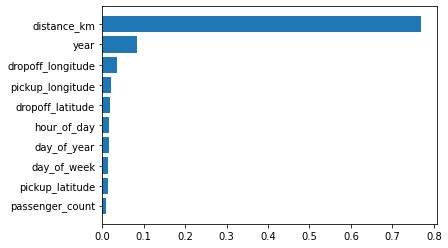

In [21]:
plt.barh(features_sorted, features_importances_sorted);

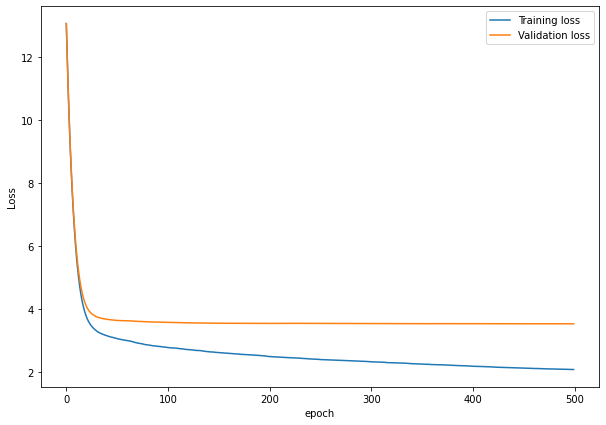

In [22]:
results = model.evals_result()

plt.figure(figsize=(10,7))
plt.plot(results["validation_0"]["rmse"], label="Training loss")
plt.plot(results["validation_1"]["rmse"], label="Validation loss")
plt.xlabel("epoch")
plt.ylabel("Loss")
plt.legend();

In [23]:
print(model.best_score)
print(model.best_iteration)
print(model.best_ntree_limit)

3.537207
499
500


## Previsões na base de dados de teste

In [24]:
y_pred = model.predict(X_test, ntree_limit=model.best_ntree_limit)

In [25]:
from sklearn.metrics import mean_squared_error
mse = mean_squared_error(y_test, y_pred)
print(f'Erro RSME = {np.sqrt(mse)}')

Erro RSME = 3.5372369149866


### Comparando as previsões com as respostas reais

In [37]:
print_every = 250

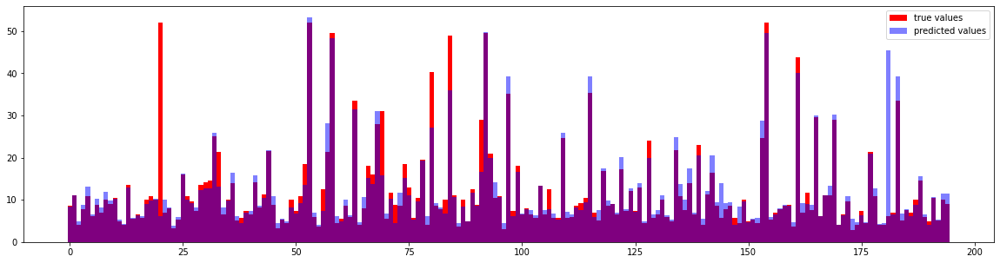

In [38]:
fig = plt.figure(figsize=(20,5))
plt.bar(list(range(len(y_test[::print_every]))), y_test.values[::print_every],
        alpha = 1, color = 'red', width = 1, label = 'true values')
plt.bar(list(range(len(y_pred[::print_every]))), y_pred[::print_every],
        alpha = 0.5, color = 'blue', width = 1, label = 'predicted values')
plt.legend();